# Practical 2: GPU training

In this practical, we will:
1. Compare CPU vs GPU compute
2. Accelerate GPU training via profiling by
    - Enabling model optimisations
    - Optimising input pipeline
    - Mixed precision training
3. Use multi-GPU / distributed training facilities in TensorFlow 2.x

***IMPORTANT***:  Save a copy of this notebook into your Drive before you start. Before you begin, go to the _Runtime_ menu, click _Change runtime type_ and ensure it is set to "Python 3" and accelerator: "GPU".

Please attempt any 9 questions. Please submit a zip file of: (a) a text file with a publicly visible link to your notebook in Google Colab; (b) a downloaded copy (ipynb) of your notebook. You may treat this as a report: we will not be re-executing the code you used to produce the answers, unless absolutely required.

Each of 3 parts the practical are independent, so you don't need to re-run previous cells if you choose to take a break once you finish a certain part. Provide your answers in a new cell below the question cell.


We can use the `nvidia-smi` command to check what GPUs the Colab environment provides.

In [ ]:
!nvidia-smi

Wed Nov  9 13:04:06 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

***IMPORTANT NOTE***: 

The Colab environment has multiple models of GPUs available, such as Tesla T4, V100, P1000 or Tesla K80. You are assigned one at random; check the output of `nvidia-smi` above to see your GPU model. 

If you're assigned an older GPU, such as Tesla K80, you may not see the results of certain performance optimisations discussed later in the practical, such as data prefetching and mixed-precision training. You can either continue with the practical, knowing that you may not see an improvement in benchmark numbers that the practical text implies, or try to get a newer GPU by requesting a new runtime.

To request a new machine, click _Runtime_ menu -> _Manage sessions_ and click Terminate next to your session. Run the `nvidia-smi` cell above to get allocated a new machine and see its GPU model. Alternatively, if you have access to a GPU server with a newer GPU, feel free to download this notebook and use a local Jupyter server there. 

# Part I: CPU vs GPU

In [ ]:
# Setup
import tensorflow as tf
import numpy as np

print("Using TensorFlow version", tf.__version__)
tf.debugging.set_log_device_placement(True) 

Using TensorFlow version 2.9.2


GPUs are a fundamentally different piece of computing equipment compared to CPUs. In contrast to CPUs, GPUs have a high-throughput data pipeline and hundreds or thousands of small processing cores, which make GPUs excel at parallel computing workloads. However, using GPUs comes at a cost of having to transfer data into their vRAM memory (so called "*host-to-device mem. copy*") and transfer the results back into RAM, as well the additional high power consumption.

To illustrate this difference, let us measure the time it takes to run a large convolution on a CPU, versus transferring the data from RAM to the GPU, performing the computation there, and transferring the results back. The benchmark code below runs the convolution 10 times.

In [ ]:
from timeit import timeit

# Create 2 matrices for convolution on a CPU
with tf.device("/cpu:0"):
    # Input: an (N, H, W, C) tensor of N "images", of size H-by-W that have C channels
    input = tf.random.uniform((128, 128, 128, 64))  
    # Kernel: a (K_H, K_W, I_C, O_C) convolutional kernel of size K_H-by-K_W that expects
    # I_C input channels (= C in 'input' tensor shape) and produces O_C "filters"
    kernel = tf.random.uniform((3, 3, 64, 96))

def conv_fn(input, kernel):
    return tf.nn.conv2d(input, kernel, strides=(1, 1), padding="VALID").numpy()

def run_benchmark():
    conv_fn(input, kernel)  # Warmup
    print(timeit(lambda: conv_fn(input, kernel), number=10), "second(s) to execute Conv2D")

with tf.device("/gpu:0"):
    run_benchmark()

with tf.device("/cpu:0"):
    run_benchmark()

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
4.505138010

*Q1*: Verify that if input and kernel sizes are small, it is not worth using GPUs to perform the computation (acceleration benefits are negated by the data transfer overheads). What are the shapes of `input` and `kernel` tensors in this case, and how long does it take to run the computation on either device?

In [ ]:
with tf.device("/cpu:0"):
    # Input: an (N, H, W, C) tensor of N "images", of size H-by-W that have C channels
    input = tf.random.uniform((8, 16, 16, 3))  
    # Kernel: a (K_H, K_W, I_C, O_C) convolutional kernel of size K_H-by-K_W that expects
    # I_C input channels (= C in 'input' tensor shape) and produces O_C "filters"
    kernel = tf.random.uniform((3, 3, 3, 64))

with tf.device("/gpu:0"):
    run_benchmark()

with tf.device("/cpu:0"):
    run_benchmark()

Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RandomUniform in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Conv2D in device /job:localhost/replica:0/task:0/device:GPU:0
0.028110972

1) As the input, I am using 8 RGB 16x16 images (so 3 input channels) and the kernel size is 3x3 with 64 output channels. The time taken on GPU is 0.02811s whereas the time taken on CPU is less at 0.02067s 

You should see that the GPU clearly excels at linear algebra computations. This allows us to accelerate neural network training and inference. However, rather than contrasting GPUs and CPUs, it's more useful to have both devices working *together asynchronously* to deliver the fastest solution.

It is possible to schedule different parts of your model on different devices to get the maximum speedup (see this [paper](https://arxiv.org/pdf/1606.04487.pdf) for example). However, for simplicity, a lot of deep learning frameworks adopt a strategy of:
1. Running a network's layers and keeping their parameters (weights) on a GPU
2. Reading and preprocessing data using a CPU
3. Preparing and transferring the next batch of data asynchronously on a CPU, while the GPU is training your network using the current batch.

This plays to strengths of both devices: linear algebra is scheduled to run on GPUs, and general-purpose computing (file-reading, simple transformations, control over what gets scheduled on a GPU, etc.) is run on a CPU.

# Part II: Accelerating GPU training

GPUs are great for parallel compute but it's up to you to ensure that your code sets things up in the right way to provide the most opportunities for parallelism. GPU-powered applications typically face two problems that prevent them from achieving full utilisation of a GPU:
1. *Not enough data is available on time to start the computation.* Your software may struggle to provide enough data for the GPU prior to starting a computation, which makes your application *IO-bound*. This leads to the GPU being *underutilised* (running the computation on less data than it could) or *stalling* (doing nothing while waiting for data to arrive). We will look at diagnosting these problems and optimising data input pipelines for neural networks shortly.
2. *The type of computation or your GPU code is not able to leverage parallelism.* Luckily, in deep learning you won't usually deal with this problem: many vendors have put a lot of effort into optimising their linear algebra programs (*kernels*) to work well on GPUs, in particular for tensor sizes usually used seen in neural networks.

We will now look into how to diagnose and fix performance issues using a profiler.

***IMPORTANT***: 

Restart the runtime (_Runtime_ -> _Restart runtime_ menu option) before executing the following cells.

In [ ]:
# It is important that you restart the runtime if you have just completed Part I, 
# otherwise you will see a lot of placement messages such as
# 'Executing op [...] in device [...]' which will significantly slow down the training.

!pip install -U tensorboard_plugin_profile tensorflow-addons
%load_ext tensorboard

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.3 MB 10.2 MB/s 
     |████████████████████████████████| 1.1 MB 41.3 MB/s 


For our performance optimisation experiments, we will be training a modified [MobileNet V2](https://arxiv.org/abs/1801.04381) model on a [CIFAR-10](https://www.cs.toronto.edu/~kriz/cifar.html) dataset. Let's load the dataset.

In [ ]:
import tensorflow as tf
import tensorflow_addons as tfa
import numpy as np 

(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()
print(f"x_train size is {x_train.shape} and the type is {x_train.dtype}")
print(f"y_train size is {y_train.shape} and the type is {y_train.dtype}")

def preprocess(x, y):
    x = x.astype('float32') / 255
    return x, y

x_train, y_train = preprocess(x_train, y_train)
x_test, y_test = preprocess(x_test, y_test)
print(f"postprocessing: x_train size is {x_train.shape} and the type is {x_train.dtype}")
print(f"postprocessing: y_train size is {y_train.shape} and the type is {y_train.dtype}")

x_train size is (50000, 32, 32, 3) and the type is uint8
y_train size is (50000, 1) and the type is uint8
postprocessing: x_train size is (50000, 32, 32, 3) and the type is float32
postprocessing: y_train size is (50000, 1) and the type is uint8


*Q2*. Where do you think `x_train` resides by default: in CPU memory (RAM) or in GPU memory? What is the shape and type (`dtype`) of the `x_train` tensor before and after preprocessing? What is the shape and type of `y_train`? (You don't need to give code that you've used to determine this.)

2) x_train should reside in CPU memory by default.

x_train size is (50000, 32, 32, 3) and the type is uint8

y_train size is (50000, 1) and the type is uint8

postprocessing: x_train size is (50000, 32, 32, 3) and the type is float32

postprocessing: y_train size is (50000, 1) and the type is uint8

From here on, we will be using the [tf.data API](https://www.tensorflow.org/guide/data) to build an input data pipeline. Technically, using this sophisticated API is not necessary for our simple case because the dataset fully fits in memory and we had no intention of doing data augmentation yet. In fact, if you simply pass in `x_train` and `y_train` to the `model.fit` function, Keras will automatically create a `tf.Data` dataset iterator with default optimisations under the hood.

However, for the purposes of this practical, we will execise control over the input pipeline by manually declaring all of its parts:
1. Data reading and preprocessing (none here)
2. Data augmentation
3. Transferring the data onto the GPU 


### tf.Data API


`tf.data.Dataset` represents data as sequences of elements (e.g. input picture and label pairs), which you can think of as Python iterators. You can operate on sequences by chaining them and transforming their elements---effectively declaring a preprocessing _pipeline_.

In [ ]:
# Create a dataset from already loaded tensors: this will slice each 
# tensor along the first axis. Thus each element is a tuple of an image 
# and a label.
# In practice, you would create a Dataset containing a list of files 
# and load them in one of the subsequent "transformation" functions.
train_data = tf.data.Dataset.from_tensor_slices((x_train, y_train))
test_data = tf.data.Dataset.from_tensor_slices((x_test, y_test))

batch_size = 128
CIFAR_10_MEANS = np.array((0.4914, 0.4822, 0.4465))
CIFAR_10_STDS = np.array((0.2023, 0.1994, 0.2010))

# Shuffle images: permute the order of images in a sequence
train_data = train_data.shuffle(8 * batch_size)

# Batch images and labels together: each element in the dataset is now
# a batch of 128 images & labels. You can also apply preprocessing to 
# each image individually and apply .batch() afterwards. 
train_data = train_data.batch(batch_size)
test_data = test_data.batch(batch_size)

def random_shift(x, shift_amount):
    """ Randomly shifts images by up to HxW pixels = `shift_amount`. """
    h_pixels, w_pixels = shift_amount
    orig = tf.shape(x)
    paddings = tf.constant([[0, 0], [w_pixels, w_pixels], [h_pixels, h_pixels], [0, 0]])
    x = tf.pad(x, mode="SYMMETRIC", paddings=paddings)
    return tf.image.random_crop(x, size=orig)

# Apply some data augmentation
def transform_examples(xs, ys):
    # Apply some simple augmentation: see tf.image and tfa.image namespaces
    # for more implemented options. Note: internally tf.image assumes that your
    # images are HxWxC or NxHxWxC float32 tensors with values in [0.0; 1.0)

    xs = tf.image.random_flip_left_right(xs)
    xs = tfa.image.random_cutout(xs, mask_size=(12, 12)) # see https://arxiv.org/abs/1708.04552
    xs = random_shift(xs, (4, 4))

    return xs, ys

def normalise_examples(xs, ys):
    # Change pixels from [0, 1) to 0-mean 1-std-dev values
    xs = (xs - CIFAR_10_MEANS) / CIFAR_10_STDS
    return xs, ys


# .map(...) applies a function to every element in the dataset sequence
# NOTE: .map(...) calls can be parallelised using the `num_parallel_calls=...` argument
train_data = train_data.map(transform_examples).map(normalise_examples)
test_data = test_data.map(normalise_examples)

Let us visualise a few training and testing examples:

Train examples:


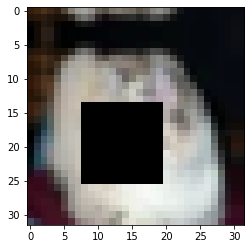

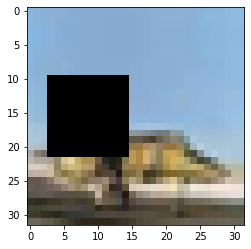

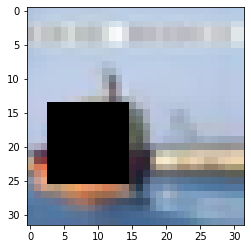

Test examples:


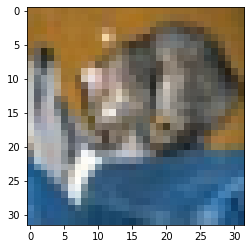

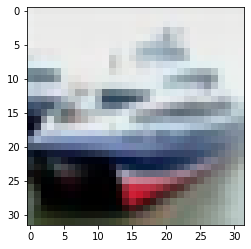

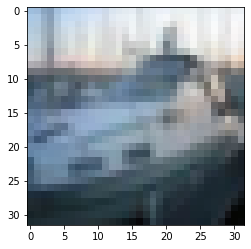

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

train_img_batch, _ = next(train_data.as_numpy_iterator())
test_img_batch, _ = next(test_data.as_numpy_iterator())

def undo_normalisation(x):
    return np.clip(x * CIFAR_10_STDS + CIFAR_10_MEANS, 0.0, 1.0)

print("Train examples:")
for i in range(3):  # Show first 3 training images (different every time!)
    plt.imshow(undo_normalisation(train_img_batch[i]))
    plt.show()

print("Test examples:")
for i in range(3):  # Show first 3 testing images
    plt.imshow(undo_normalisation(test_img_batch[i]))
    plt.show()

*Q3*. `.shuffle()` requires you to specify a buffer size into which the samples are loaded and read out in a random order. Why do you think this is necessary? What would the alternative approach entail? Discuss. Hint: `tf.data` APIs are optimised for sequential data read, which is faster for most disk drives than random access read. 


3) This is likely necessary, as some datasets may be too large to store in memory at the same time, before shuffling. Instead we load buffer_size (where buffer_size is likely less than the total number of examples) elements into a buffer and randomly select from that buffer. The alternative would be to randomly select a number between 0 and num_examples-1 and then load that example from the disk drive. As the question mentions, random access for disk drives is slow and it is faster to do a sequential data read of size buffer_size from disk to a buffer (in RAM) and then perform random access read from the buffer.

Now, let's assemble the MobileNet V2 model:

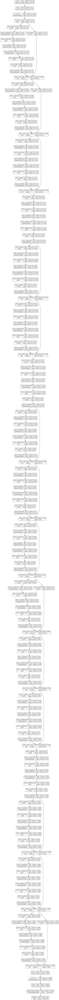

In [ ]:
from tensorflow.keras import layers
from tensorflow.keras.models import Model

def mobilenet_v2_like(input_shape=(32, 32, 3), num_classes=10):
    def _inverted_res_block(i, filters, alpha, stride, expansion, block_id):
        prefix = 'block_{}_'.format(block_id)
        in_channels = i.shape[-1]
        x = i

        # Expand
        x = layers.Conv2D(expansion * in_channels, kernel_size=1, padding='valid',
                          use_bias=False, activation=None, name=prefix + 'expand')(x)
        x = layers.BatchNormalization(name=prefix + 'expand_BN')(x)
        x = layers.ReLU(name=prefix + 'expand_relu')(x)

        # Depthwise
        x = layers.DepthwiseConv2D(kernel_size=3, strides=stride, activation=None,
                                   use_bias=False, padding='same', name=prefix + 'depthwise')(x)
        x = layers.BatchNormalization(name=prefix + 'depthwise_BN')(x)
        x = layers.ReLU(name=prefix + 'depthwise_relu')(x)

        # Project
        pointwise_filters = int(filters * alpha)
        x = layers.Conv2D(pointwise_filters, kernel_size=1, padding='valid', use_bias=False,
                          activation=None, name=prefix + 'project')(x)
        x = layers.BatchNormalization(name=prefix + 'project_BN')(x)

        if stride == 1:
            if in_channels != pointwise_filters:
                i = layers.Conv2D(pointwise_filters, kernel_size=1, padding='valid', use_bias=False,
                                  activation=None, name=prefix + 'adjust')(i)
            x = layers.Add(name=prefix + 'add')([i, x])
        return x

    i = layers.Input(shape=input_shape)
    x = i

    alpha = 1.0
    x = layers.Conv2D(32, kernel_size=3, strides=(1, 1),
                      padding='same', use_bias=False, name='Conv1')(x)
    x = layers.BatchNormalization(name='bn_Conv1')(x)
    x = layers.ReLU(name='Conv1_relu')(x)

    x = _inverted_res_block(x, filters=16, alpha=alpha, stride=1, expansion=1, block_id=0)

    x = _inverted_res_block(x, filters=24, alpha=alpha, stride=1, expansion=6, block_id=1)
    x = _inverted_res_block(x, filters=24, alpha=alpha, stride=1, expansion=6, block_id=2)

    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=2, expansion=6, block_id=3)
    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1, expansion=6, block_id=4)
    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1, expansion=6, block_id=5)

    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=2, expansion=6, block_id=6)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=7)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=8)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=9)

    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=10)
    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=11)
    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=12)

    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=2, expansion=6, block_id=13)
    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, expansion=6, block_id=14)
    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, expansion=6, block_id=15)

    x = _inverted_res_block(x, filters=320, alpha=alpha, stride=1, expansion=6, block_id=16)

    x = layers.Conv2D(1280, kernel_size=1, use_bias=False, name='Conv_1', padding="valid")(x)
    x = layers.BatchNormalization(name='Conv_1_bn')(x)
    x = layers.ReLU(name='out_relu')(x)

    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(num_classes, name='predictions')(x)

    return Model(i, x)

model = mobilenet_v2_like()

# Print a tabular summary of model architecture
# model.summary()

# Plot model graph
tf.keras.utils.plot_model(model, show_shapes=True, show_layer_names=True, to_file='mobilenet.png')
from IPython.display import Image
Image(retina=True, filename='mobilenet.png')

Above, you see the network architecture graph. Now, let's set up model training:

In [ ]:
from tensorflow.keras.callbacks import LearningRateScheduler, TensorBoard
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import SGD

# Note the "Sparse..." loss from logits, because labels are integers and we don't include the softmax layer
model.compile(loss=SparseCategoricalCrossentropy(from_logits=True),   
              optimizer=SGD(lr=0.1, momentum=0.9, decay=0.0, nesterov=False),
              metrics=['accuracy'], run_eagerly=True)


# If you suspect that the runtime added the batch prefetching optimisation (discussed in the next experimemt), 
# try explicitly disabling it in this experiment by uncommenting the following 2 lines. You may need to restart
# the runtime and run Part II from scratch.
# train_data = train_data.prefetch(0)
# test_data = test_data.prefetch(0)

def train_model(model):
    def lr_schedule(epoch):
        if 0 <= epoch < 35:
            return 0.1
        if 35 <= epoch < 65:
            return 0.01
        return 0.001

    model.fit(
        train_data, validation_data=test_data, 
        epochs=2, # NOTE: we train for 1 epoch in this instance, but you can train for 90 epochs to get a model with good accuracy
        callbacks=[
            LearningRateScheduler(lr_schedule),
            TensorBoard(log_dir="./tb_logs", profile_batch='25, 35')  # Profile between the 25th and 35th forward pass
        ])

...and finally train the model: you may notice a brief slow-down while profiling is on.

In [ ]:
train_model(model)

Epoch 1/2
391/391 [==============================] - 90s 229ms/step - loss: 1.5036 - accuracy: 0.4487 - val_loss: 2.1466 - val_accuracy: 0.3882 - lr: 0.1000
Epoch 2/2
391/391 [==============================] - 87s 224ms/step - loss: 1.2707 - accuracy: 0.5366 - val_loss: 1.5835 - val_accuracy: 0.5269 - lr: 0.1000


Now, let's inspect the traces produced by the profiler in TensorBoard. 

TensorBoard is a tool for inspecting and visualising what your model is doing during training. After running the cell below, you will be able to check out the "Scalars" tab for progress on your tracked metrics and losses (useful if trained for more than 1 epoch). 

We're interested in the "**Profile**" tab: select *Profile* in the top bar or in dropdown menu in the top right corner of the TensorBoard window. 

In [ ]:
%tensorboard --logdir ./tb_logs

You will be presented with an overview page. Note the Runs, Tools and Hosts dropdown menus on the left: you can choose between different profiling runs, and we will be making use of different tools in the Tools menu. Once you're done with TensorBoard you can click the (X) button under the play button on the left of the cell to close it (we'll load it again later on).

*Q4*. Inspect the "Step-time graph", "Performance summary" and recommendations for next steps. Approximately, what fraction of time is taken up by input data processing and Python overheads ("All others")?

4) Input data processing and Python overheads take up 18.8% of the step time.

## Optimisation 1: Reducing latency by compiling the model

If you noticed, in the `model.compile(...)` call earlier, we specified `run_eagerly=True`. This enables eager execution in TensorFlow (your layers will be run as soon as Python code invokes them), akin to PyTorch. Unfortunately, frequent context-switching between Python and native code, together with a lack of optimisations, results in our model running slower than it could. 

We can disable eager execution (which is the default, so we simply don't pass in the `run_eagerly` parameter) and also enable an [optimising JIT compiler](https://www.tensorflow.org/xla) to reap some performance benefits:

In [ ]:
tf.keras.backend.clear_session()
# Note that due to this you won't be able to see individual ops in the profiler, only a singular "_XlaRun"
tf.config.optimizer.set_jit(True)

model = mobilenet_v2_like()
model.compile(loss=SparseCategoricalCrossentropy(from_logits=True),   
              optimizer=SGD(lr=0.1, momentum=0.9, decay=0.0, nesterov=False),
              metrics=['accuracy'])

train_model(model)

Epoch 1/2
391/391 [==============================] - 67s 133ms/step - loss: 1.8056 - accuracy: 0.3594 - val_loss: 1.6571 - val_accuracy: 0.3889 - lr: 0.1000


KeyboardInterrupt: ignored

Now, let's reload TensorBoard and **choose the latest run from the Runs menu**:

In [ ]:
%tensorboard --logdir ./tb_logs

You should see a reduction in "Device Compute Time" and "All others" section being (nearly) eliminated due to (a) TensorFlow assembling a model graph internally, rather than relying on Python code to tell it what to do for each batch, and (b) JIT optimising the said graph to obtain a faster model.

**Note**: you may see an increase in "all others" at the last batch, which appears to be due to finishing the profiling.

## Optimisation 2: Data pipelining

Conventionally, a _training loop_ would look as follows in most deep learning frameworks (hidden within `model.fit` in Keras; explicit in PyTorch or bare TensorFlow):
```python
for data_batch, label_batch in training_data:
    # ... perform a forward pass on `model(data_batch)`
    # ... compute the loss using model output and labels
    # ... perform a backward pass and update parameters
```

Note that the next batch is not requested until the model finishes updating its parameters. It takes some time to produce a batch and transfer it to the GPU memory, which means that the GPU will be stalling if the next batch of data is not already available in vRAM. This is especially noticeable in a multi-GPU setting, where _N_ batches are requested at once. 

Thus the second performance issue with our setup is that batch creation and transfer (done by a CPU) is performed sequentially (synchronously) with GPU computations. In fact, you can see in the `trace_viewer` tool (zoom in and navigate using W, A, S and D keys) that for each step (batch) host-to-device (CPU-to-GPU) data transfer ("MemcpyH2D") happens right before the layers are executing. This confirms the hypothesis that the GPU is stalling while waiting for data.

Since producing input data on a CPU & transferring it over to the GPU is independent from training the network on a GPU, we can hide this latency by precomputing and transfering (_prefetching_) _N_ batches while the network is running, so that they are immediately available for the next training iteration.

In [ ]:
train_data = train_data.prefetch(1)  # prefetch 1 batch
test_data = test_data.prefetch(1)

model = mobilenet_v2_like()
model.compile(loss=SparseCategoricalCrossentropy(from_logits=True),   
              optimizer=SGD(lr=0.1, momentum=0.9, decay=0.0, nesterov=False),
              metrics=['accuracy'])

train_model(model)

Epoch 1/2
391/391 [==============================] - 66s 129ms/step - loss: 1.8417 - accuracy: 0.3388 - val_loss: 1.8971 - val_accuracy: 0.3252 - lr: 0.1000
Epoch 2/2
391/391 [==============================] - 60s 153ms/step - loss: 1.3874 - accuracy: 0.4942 - val_loss: 2.2883 - val_accuracy: 0.3447 - lr: 0.1000


You should see "Input time" being eliminated on TensorBoard in the latest run (and confirm that the delay is gone in the `trace_viewer` tool, if you wish).

**Note**: you may see an increase in "all others" at the last batch, which appears to be due to finishing the profiling.

In [ ]:
%tensorboard --logdir ./tb_logs

*Q5*. Can you think of any disadvantages or costs of batch prefetching, that may cause you not to use it?

5) Batch prefetching means that we are using more memory in GPU RAM since an additional batch(s) is stored in GPU RAM. If there is enough space then it is unlikely for this to be an issue but if there isn't then we may see some of the overflow data needing to be stored in normal RAM. The resulting I/O from transferring to and from RAM to GPU RAM may in the end result in more overhead than the gain we hoped to get from prefetching.

## Optimisation 3: Mixed precision training

Thus far, our model used the `float32` data-type for its parameters (weights), which occupy 32-bits (4-bytes) per element. However, modern nVidia cards have specialised TensorCores, which can run operations faster in the 16-bit precision and read data from memory faster due to it now occupying 2 bytes per element. The model can make use of both 16-bit and 32-bit floating-point types during training to make it run faster and use less memory. 

The following will enable 16-bit operations. Note that certain parts of the model are kept in 32-bit precision to ensure that the model remains just as accurate as it would have been in full-precision.



In [ ]:
tf.keras.backend.clear_session()
policy = tf.keras.mixed_precision.Policy('mixed_float16')
tf.keras.mixed_precision.set_global_policy(policy)

model = mobilenet_v2_like()
model.compile(loss=SparseCategoricalCrossentropy(from_logits=True),   
              optimizer=SGD(lr=0.1, momentum=0.9, decay=0.0, nesterov=False),
              metrics=['accuracy'])

print(model.layers[1].name, 
      "output type:", model.layers[1].output.dtype,
      "kernel type:", model.layers[1].weights[0].dtype)

train_model(model)

Conv1 output type: <dtype: 'float16'> kernel type: <dtype: 'float32'>
Epoch 1/2
391/391 [==============================] - 63s 81ms/step - loss: 1.9267 - accuracy: 0.3191 - val_loss: 1.7608 - val_accuracy: 0.3710 - lr: 0.1000
Epoch 2/2
391/391 [==============================] - 52s 134ms/step - loss: 1.4159 - accuracy: 0.4798 - val_loss: 1.6944 - val_accuracy: 0.4906 - lr: 0.1000


Now, let's observe reduced time taken in the "Device Compute Time" section: 

In [ ]:
%tensorboard --logdir ./tb_logs

Reusing TensorBoard on port 6006 (pid 1445), started 0:06:54 ago. (Use '!kill 1445' to kill it.)

<IPython.core.display.Javascript object>

*Q6*. `float16` is a "narrower" data-type compared to `float32`: large or small numbers can overflow (rounded up to infinity) or underflow (rounded down to 0), which can cause problems when computing gradients. Loss scaling can help: read about it [here](https://www.tensorflow.org/guide/mixed_precision) and explain why it works in 1 sentence.

6) With loss scaling, the loss calculated every training step is multiplied by a large number (>1, e.g. 1024) so that when the gradients are computed, they are also scaled by this number, decreasing the likelihood of underflow and once the final gradients are computed they are divided by the scaling factor to get to correct values. 

*Q7 (optional)*. Try profiling a different model (e.g. a ResNet) or using a different image classification dataset. What are the performance bottlenecks in your case? Make note of optimisation suggestions the profiler makes; read [this optimisation guide](https://www.tensorflow.org/guide/data_performance) if you find that data input pipeline becomes your bottleneck. 

There are some prebuilt models available in the [`tf.keras.applications`](https://www.tensorflow.org/api_docs/python/tf/keras/applications) namespace, though it's up to you to make sure that the architecture looks sensible for your chosen dataset input size: for example, that the architecture is not reducing spatial dimensionality too quickly (which is why we used a modified MobileNet V2 rather than an off-the-shelf one earlier).

# Part III: Multi-GPU training

***IMPORTANT***: Restart the runtime (_Runtime_ -> _Restart runtime_ menu option) before executing the following cells.

As Colab typically provides one GPU, we create virtual/logical (simulated) GPUs on top to simulate a multi-GPU set-up. This is useful for quick local experiments before submitting a job onto a multi-GPU cluster.

In [ ]:
import tensorflow as tf
import tensorflow_addons as tfa
import numpy as np

print("Using TensorFlow version", tf.__version__)

gpus = tf.config.list_physical_devices('GPU')
assert gpus is not None

# Split the only GPU (`gpus[0]`) into 2 logical GPUs, capped at 2GB memory each
tf.config.set_logical_device_configuration(gpus[0], [
    tf.config.LogicalDeviceConfiguration(memory_limit=2048),
    tf.config.LogicalDeviceConfiguration(memory_limit=2048)
])

logical_gpus = tf.config.list_logical_devices('GPU')
print(f"{len(gpus)} physical GPUs viewed as {len(logical_gpus)} logical GPUs: {[d.name for d in logical_gpus]}")

Using TensorFlow version 2.9.2
1 physical GPUs viewed as 2 logical GPUs: ['/device:GPU:0', '/device:GPU:1']


Let's recreate the MobileNet V2 architecture and CIFAR-10 data input pipeline:

In [ ]:
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

def preprocess(x, y):
    x = x.astype('float32') / 255
    return x, y

train_data = tf.data.Dataset.from_tensor_slices(preprocess(x_train, y_train))
test_data = tf.data.Dataset.from_tensor_slices(preprocess(x_test, y_test))

batch_size = 128
CIFAR_10_MEANS = np.array((0.4914, 0.4822, 0.4465))
CIFAR_10_STDS = np.array((0.2023, 0.1994, 0.2010))

def random_shift(x, shift_amount):
    """ Randomly shifts images by up to HxW pixels = `shift_amount`. """
    h_pixels, w_pixels = shift_amount
    orig = tf.shape(x)
    paddings = tf.constant([[0, 0], [w_pixels, w_pixels], [h_pixels, h_pixels], [0, 0]])
    x = tf.pad(x, mode="SYMMETRIC", paddings=paddings)
    return tf.image.random_crop(x, size=orig)

def transform_examples(xs, ys):
    xs = tf.image.random_flip_left_right(xs)
    xs = tfa.image.random_cutout(xs, mask_size=(12, 12))
    xs = random_shift(xs, (4, 4))
    return xs, ys

def normalise_examples(xs, ys):
    xs = (xs - CIFAR_10_MEANS) / CIFAR_10_STDS
    return xs, ys

train_data = train_data \
    .shuffle(8 * batch_size) \
    .batch(batch_size) \
    .map(transform_examples) \
    .map(normalise_examples)
test_data = test_data \
    .batch(batch_size) \
    .map(normalise_examples)

In [ ]:
from tensorflow.keras import layers
from tensorflow.keras.models import Model

def mobilenet_v2_like(input_shape=(32, 32, 3), num_classes=10):
    def _inverted_res_block(i, filters, alpha, stride, expansion, block_id):
        prefix = 'block_{}_'.format(block_id)
        in_channels = i.shape[-1]
        x = i

        # Expand
        x = layers.Conv2D(expansion * in_channels, kernel_size=1, padding='valid',
                          use_bias=False, activation=None, name=prefix + 'expand')(x)
        x = layers.BatchNormalization(name=prefix + 'expand_BN')(x)
        x = layers.ReLU(name=prefix + 'expand_relu')(x)

        # Depthwise
        x = layers.DepthwiseConv2D(kernel_size=3, strides=stride, activation=None,
                                   use_bias=False, padding='same', name=prefix + 'depthwise')(x)
        x = layers.BatchNormalization(name=prefix + 'depthwise_BN')(x)
        x = layers.ReLU(name=prefix + 'depthwise_relu')(x)

        # Project
        pointwise_filters = int(filters * alpha)
        x = layers.Conv2D(pointwise_filters, kernel_size=1, padding='valid', use_bias=False,
                          activation=None, name=prefix + 'project')(x)
        x = layers.BatchNormalization(name=prefix + 'project_BN')(x)

        if stride == 1:
            if in_channels != pointwise_filters:
                i = layers.Conv2D(pointwise_filters, kernel_size=1, padding='valid', use_bias=False,
                                  activation=None, name=prefix + 'adjust')(i)
            x = layers.Add(name=prefix + 'add')([i, x])
        return x

    i = layers.Input(shape=input_shape)
    x = i

    alpha = 1.0
    x = layers.Conv2D(32, kernel_size=3, strides=(1, 1),
                      padding='same', use_bias=False, name='Conv1')(x)
    x = layers.BatchNormalization(name='bn_Conv1')(x)
    x = layers.ReLU(name='Conv1_relu')(x)

    x = _inverted_res_block(x, filters=16, alpha=alpha, stride=1, expansion=1, block_id=0)

    x = _inverted_res_block(x, filters=24, alpha=alpha, stride=1, expansion=6, block_id=1)
    x = _inverted_res_block(x, filters=24, alpha=alpha, stride=1, expansion=6, block_id=2)

    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=2, expansion=6, block_id=3)
    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1, expansion=6, block_id=4)
    x = _inverted_res_block(x, filters=32, alpha=alpha, stride=1, expansion=6, block_id=5)

    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=2, expansion=6, block_id=6)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=7)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=8)
    x = _inverted_res_block(x, filters=64, alpha=alpha, stride=1, expansion=6, block_id=9)

    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=10)
    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=11)
    x = _inverted_res_block(x, filters=96, alpha=alpha, stride=1, expansion=6, block_id=12)

    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=2, expansion=6, block_id=13)
    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, expansion=6, block_id=14)
    x = _inverted_res_block(x, filters=160, alpha=alpha, stride=1, expansion=6, block_id=15)

    x = _inverted_res_block(x, filters=320, alpha=alpha, stride=1, expansion=6, block_id=16)

    x = layers.Conv2D(1280, kernel_size=1, use_bias=False, name='Conv_1', padding="valid")(x)
    x = layers.BatchNormalization(name='Conv_1_bn')(x)
    x = layers.ReLU(name='out_relu')(x)

    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(num_classes, name='predictions')(x)

    return Model(i, x)

## Multi-GPU training

In TensorFlow 2.x API, multi-GPU training can be achieved by prepending 2 lines of code to our previous model creation code:

In [ ]:
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import SGD 

strategy = tf.distribute.MirroredStrategy()
with strategy.scope():
    # Create a model within a strategy scope
    model = mobilenet_v2_like()

    model.compile(loss=SparseCategoricalCrossentropy(from_logits=True),   
              optimizer=SGD(lr=0.1, momentum=0.9, decay=0.0, nesterov=False),
              metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/keras/optimizers/optimizer_v2/gradient_descent.py:108: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


While it's a small change in user code, distribution strategies make a lot of complex changes in a way the models are executed. Parallel processing of neural networks can feature 2 kinds of parallelism:
* Data parallelism: As neural network has to process many elements at once during training (`batch_size`-many), it makes sense to split the batch into multiple parts (or take _N_ batches from `tf.data.Dataset`), process them in parallel, and then aggregate the results at the end. In this case, each GPU gets an instantiation (a copy or a *replica*) of the model, with parameters being _shared_ across all instances (replicas). During the backward pass, computed gradients (parameter updates) are distributed among the devices to keep the parameter values in sync.
* Model parallelism: Different parts (layers) of the model can reside on different GPUs. Then, for example, the first part of the model can execute the following batch as soon as it hands over its results to the second part.

*Q8.* Splitting your model across multiple devices will incur a performance penalty due to communication costs between devices. In what cases would model parallelism be useful? 

8) Model parallelism is useful when the data flows sequentially through a model, this allows the processing to be viewed as a pipeline, where each component of the pipeline can be processing a different batch. This pipeline is optimal when each component takes the same amount of time to compute, otherwise there will be pipeline stalls. If such a pipeline had N components then we could see an reduction by factor of N in processing time over a non-pipelined implementation. If we consider the performance penalties due to communications between the N components as an extra time of $P_N$ then we will see an improvement if $\frac{T}{N} + P_N < T$ where $T$ is the original time taken for the model to compute its output in a non-pipelined implementation.

In [ ]:
from tensorflow.keras.callbacks import LearningRateScheduler

def lr_schedule(epoch):
    if 0 <= epoch < 35:
        return 0.1
    if 35 <= epoch < 65:
        return 0.01
    return 0.001

model.fit(
    train_data, validation_data=test_data, 
    epochs=5, # NOTE: we train for 5 out of 90 epochs in this instance to finish sooner
    callbacks=[
        LearningRateScheduler(lr_schedule)
    ])

Epoch 1/5
391/391 [==============================] - 83s 163ms/step - loss: 1.9147 - accuracy: 0.3282 - val_loss: 1.7041 - val_accuracy: 0.3725 - lr: 0.1000
Epoch 2/5
391/391 [==============================] - 58s 149ms/step - loss: 1.4279 - accuracy: 0.4800 - val_loss: 1.8027 - val_accuracy: 0.4845 - lr: 0.1000
Epoch 3/5
391/391 [==============================] - 58s 149ms/step - loss: 1.1835 - accuracy: 0.5732 - val_loss: 1.2211 - val_accuracy: 0.6089 - lr: 0.1000
Epoch 4/5
391/391 [==============================] - 58s 149ms/step - loss: 1.0344 - accuracy: 0.6298 - val_loss: 0.9028 - val_accuracy: 0.6826 - lr: 0.1000
Epoch 5/5
391/391 [==============================] - 58s 149ms/step - loss: 0.9194 - accuracy: 0.6742 - val_loss: 1.0223 - val_accuracy: 0.6733 - lr: 0.1000


The strategy used above implements data paralellism. Each GPU runs a replica of the model with a batch of images 128 and the outputs and parameter updates are aggregated from 2 replicas, making them look like they've been computed from from 256 samples (called the *global batch size*). Normalising over the batch size is typically done in the loss function, there's more information [here](https://www.tensorflow.org/tutorials/distribute/custom_training#define_the_loss_function) about scaling your loss by the global batch size (handled in `model.fit` automatically). 

*Q9.* In our model we've used a batch normalization layer, which computes the mean and variance of its input _across the entire batch_ during the forward pass of the network. How does this interact with data parallelism? How would you make batch norm behave in a multi-GPU setting? Hint: should it normalise across the local or global batch? [see: here](https://www.tensorflow.org/api_docs/python/tf/keras/layers/experimental/SyncBatchNormalization).

9) This introduces some issues with data parallelism since the mean and variance needs to be calculated using all of the batch whereas each replica only has access to a subset of the batch. This means we either need to perform normalisation differently: either on a local batch basis or we need some syncronisation between replicas to compute the statistics for the global batch.

Batch normalisation should still normalise across the global batch even when we are employing data-parallelism. After each training step there needs to be a syncronisation step that aggregates the statistics from each replica to calculate the batch mean and variance. Then these statistics needs to be sent back to each replica. This can be done via an application of an allreduce operation. 

In data parallelism mode, inputs and intermediate tensors (activations) are unique for each replica but the parameters (weights) are shared. We have to choose where the parameters are stored and how they're updated. TensorFlow provides [2 main options for synchronous training](https://www.tensorflow.org/api_docs/python/tf/distribute):
* Parameter server strategy (aka *centralised storage strategy* when used on a single machine). This strategy designates one device (or more) to act as the reputable source for parameter values: each worker GPU sends parameter   updates to that device and variables are read from it after all updates are complete. While this allows few messages to be sent between devices, the server device becomes a performance bottleneck.
* Mirrored (all-reduce) strategy. In this setting, all devices keep their own copy of parameters and synchronise after each training pass by communicating updates to each other (also known as the [all-reduce parallel pattern](https://en.wikipedia.org/wiki/Reduce_(parallel_pattern))). As this can generate a lot of traffic during communication phase, but there are ways to reduce the number of messages.

You can read more about all-reduce strategies and, in particular, *ring* all-reduce and other considerations on the [Horovod distributed deep learning framework](https://eng.uber.com/horovod/) page (note that the code examples are outdated). The above strategies perform updates synchronously---there's also research available on training deep models [asynchronously](https://arxiv.org/abs/1609.08326). 

The mirrored strategy has proven itself to be a reasonable scalable default for most applications.

*Q10.* On a real multi-GPU system, how do you think each strategy would scale as the number of GPUs increases?

10)

*   Parameter server strategy - We will see $O(N)$ messages after each training step which is not great. If multiple parameter servers are used, this problem becomes worse and the communication pattern becomes all-to-all which could saturate the network connections.
*   All-reduce strategy - If an implementation like ring all-reduce is used, the communication strain is decreased. Even though there are $O(N^2)$ messages per training step, each message is much smaller and the communication scheme is considered to be bandwidth optimal. Furthermore it removes the bottleneck problem of the parameter server and the speed of all-reduce is dependant on the slowest link in the network.



## Aside: Low-level API
The Keras API we saw earlier (model objects and training using `model.fit()`) is a neat way of using TensorFlow, but it might be too high-level if you want to implement something that requires you to have more control over how your model is trained. You can use a PyTorch-style *forward-pass-compute-gradients-update-parameters* training loop. See [this tutorial for more info](https://www.tensorflow.org/tutorials/customization/custom_training_walkthrough). All optimiser classes and gradient computations are, by default, aware of a multi-GPU strategy you're using. 

If you want different parts of your model to reside on different devices (CPUs, GPUs), you can control operation placement manually using the [tf.Device API](https://www.tensorflow.org/api_docs/python/tf/device) (like we did in Part I). When creating your custom layers, you can tell TensorFlow how to aggregate variables (like weight matrices) across multiple GPUs using the [tf.VariableAggregation API](https://www.tensorflow.org/api_docs/python/tf/VariableAggregation) (i.e. should they be added up, or should it compute the mean value, or perhaps keep only one out of N computed values etc.). You can also control if the aggregation should happen when the variable is written to (default) or when it's read from (useful when there are more writes than reads to a variable) using the [tf.VariableSynchronization API](https://www.tensorflow.org/api_docs/python/tf/VariableSynchronization). 

You can also read more about tuning the performance of a `tf.data.Dataset` pipeline [here](https://www.tensorflow.org/guide/data_performance).

(c) 2022 Edgar Liberis. Licence CC BY 4.0. Material adapted from TensorFlow tutorials on distributed training, profiling and mixed precision training.